In [18]:
import numpy as np
import matplotlib.pyplot as plt
import corner
import pandas as pd
import random
import matplotlib
import sys

from copy import deepcopy

from scipy.interpolate import interp1d
from astropy.cosmology import FlatLambdaCDM

import semlinlens_v2bRprior as lens
import func_get_h_eta as h_eta
import func_get_rel_CK as relCK

#redirect to wherever pygravlens is stored
sys.path.insert(0,'/home/dilys/pygravlens/')
import pygravlens as gl

In [15]:
plt.rcParams.update({'font.size': 16, 'text.usetex': False})
dpi_set=400
plt.rc('axes', labelsize=16)

from astropy.cosmology import FlatLambdaCDM
cosmo100 = FlatLambdaCDM(H0=100,Om0=0.315)

# source and lens redshift:
zsrc = 2.0
zlens = 0.3

#true h where H0=100h km/s/Mpc, and true mass power law slope (1 is isothermal)
h_true = 0.7
eta_true = 1.0

%matplotlib inline
folder = './'

### ENTER NUMBER OF SAMPLES:
n_samples = 13

In [20]:
### FILE NAMES
root = 'mock_'

files = []
datfiles = []
bests = []
for n in range(1,n_samples+1):
    datfiles.append(folder+root+str(n)+'.dat')
    files.append(folder+root+str(n)+'.txt')
    bests.append(folder+root+str(n)+'-best.txt')

Read image data from file ./mock_1.dat
<r> = 1.042
Optimizing
best so far: 754411.2704199459 [-0.31856618 -0.22025252  0.37360505  2.71084171  0.44138307  0.53713997
  1.71262368  0.93666826  1.16315668]
best so far: 1.1835594660060729e-07 [ 7.49711424e-02  4.11187469e-02  1.99995043e-01  1.60232765e-09
 -4.80772699e-06 -2.47697996e-07  9.99998183e-01  1.00002093e+00
  6.99052497e-01]
best so far: 1.0047254010878848e-07 [ 7.49714577e-02  4.11190157e-02  1.99997095e-01 -4.01665475e-07
 -1.81330770e-06 -1.55949092e-06  9.99999080e-01  1.00001299e+00
  6.99057831e-01]
best so far: 8.496674507213428e-08 [ 7.49712054e-02  4.11188414e-02  1.99996268e-01 -8.00424054e-08
 -2.01662344e-06 -5.01548565e-07  9.99999357e-01  1.00001726e+00
  6.99054179e-01]
best so far: 6.94397674266413e-08 [ 7.49712598e-02  4.11189265e-02  1.99997150e-01  1.00210515e-08
 -1.13975720e-07 -1.94138283e-07  1.00000015e+00  1.00001446e+00
  6.99054750e-01]
best so far: 6.912592970854682e-08 [ 7.49712526e-02  4.11189297

emcee main run
final optimization:
2.3218979265530285e-08 [-1.59199977e-02 -9.72544332e-02  2.00000392e-01 -2.72575818e-07
  8.47972691e-07 -1.01523809e-06  9.99999281e-01  9.99998842e-01
  6.99066495e-01]
final optimization:
2.3218979265530285e-08 [-1.59199977e-02 -9.72544332e-02  2.00000392e-01 -2.72575818e-07
  8.47972691e-07 -1.01523809e-06  9.99999281e-01  9.99998842e-01
  6.99066495e-01]
Read image data from file ./mock_6.dat
<r> = 1.042
Optimizing
best so far: 1.1035789404404285e-06 [5.58027039e-02 1.98161250e-01 1.99991250e-01 8.86803290e-07
 6.63548209e-06 3.05076890e-06 9.99998247e-01 1.00004680e+00
 6.99028171e-01]
best so far: 1.0342747512306864e-06 [ 5.58035260e-02  1.98163133e-01  1.99991160e-01  5.47339293e-07
 -1.04290060e-06  1.78053743e-06  1.00000078e+00  1.00003928e+00
  6.99035966e-01]
best so far: 9.395091040389567e-07 [5.58028567e-02 1.98162057e-01 1.99992224e-01 6.48997463e-07
 7.41928007e-06 2.31385418e-06 9.99997791e-01 1.00004318e+00
 6.99028439e-01]
best so 

best so far: 21670.148189497013 [ 0.09284086 -0.13247244  0.13572823 -0.01318752 -0.00652041  0.0021271
  1.14725588  0.95900924  1.16149594]
best so far: 8.9085666526904e-06 [ 1.03385090e-01 -1.82124739e-01  2.00002918e-01  5.29640746e-06
  8.12664027e-06  1.64450254e-05  9.99989658e-01  9.99995849e-01
  6.99059226e-01]
best so far: 7.092193325347629e-06 [ 1.03375633e-01 -1.82105097e-01  1.99979380e-01 -4.15658603e-06
 -2.39911552e-06 -1.29234908e-05  9.99997770e-01  1.00009594e+00
  6.99001422e-01]
best so far: 4.524969782883996e-06 [ 1.03384141e-01 -1.82117444e-01  1.99984503e-01  5.71353588e-07
 -3.26598341e-05  3.43669546e-06  9.99986825e-01  1.00003826e+00
  6.99066078e-01]
best so far: 4.187739179270514e-06 [ 1.03379696e-01 -1.82112962e-01  1.99987829e-01 -3.33149788e-07
 -2.04916431e-06 -7.01481528e-07  1.00000124e+00  1.00005605e+00
  6.99027298e-01]
best so far: 2.9868017100783196e-06 [ 1.03379777e-01 -1.82114126e-01  1.99991255e-01 -6.12808659e-07
  6.24162346e-06 -2.5978234

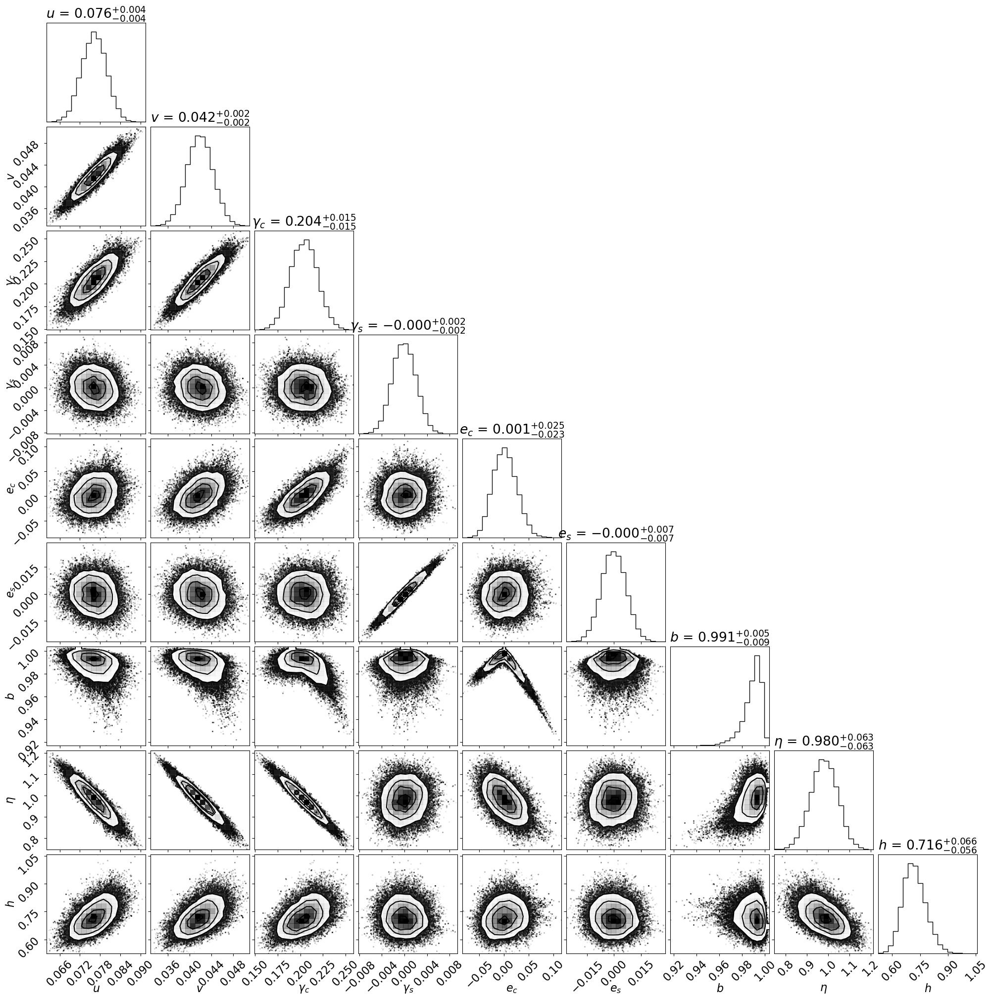

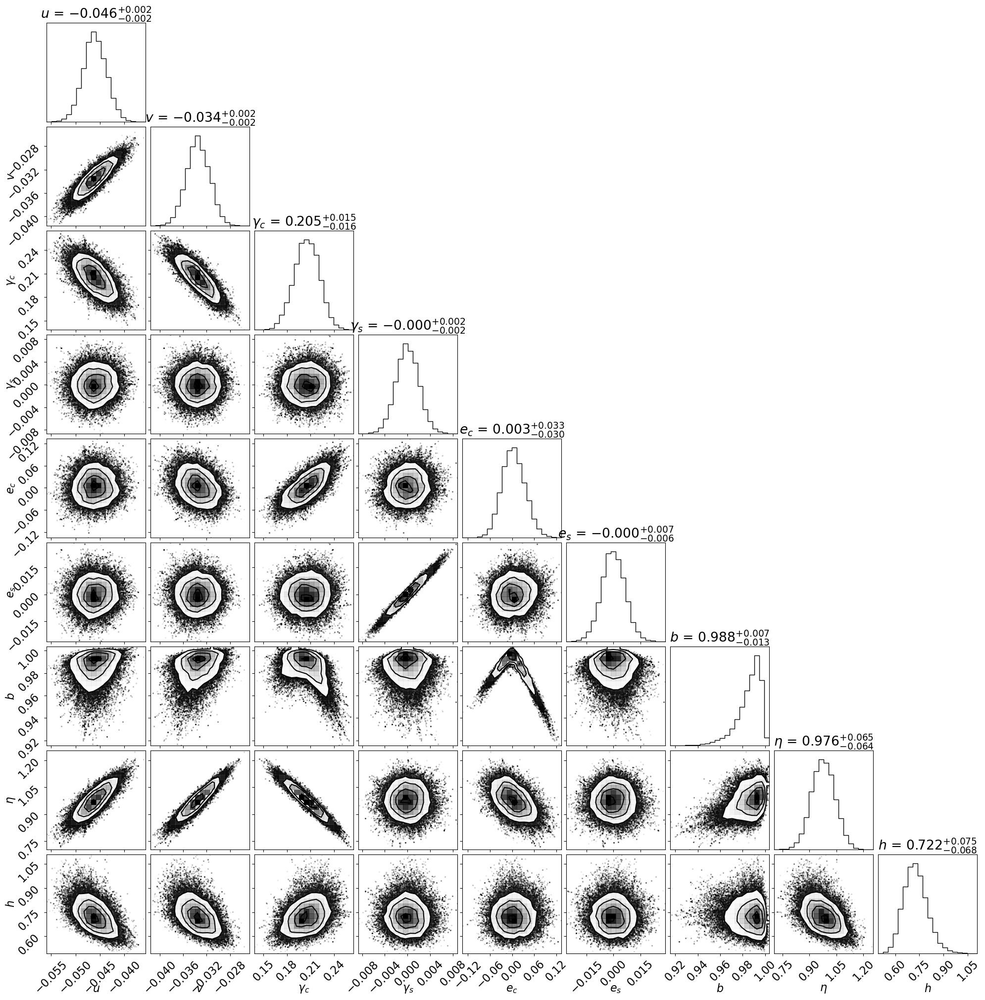

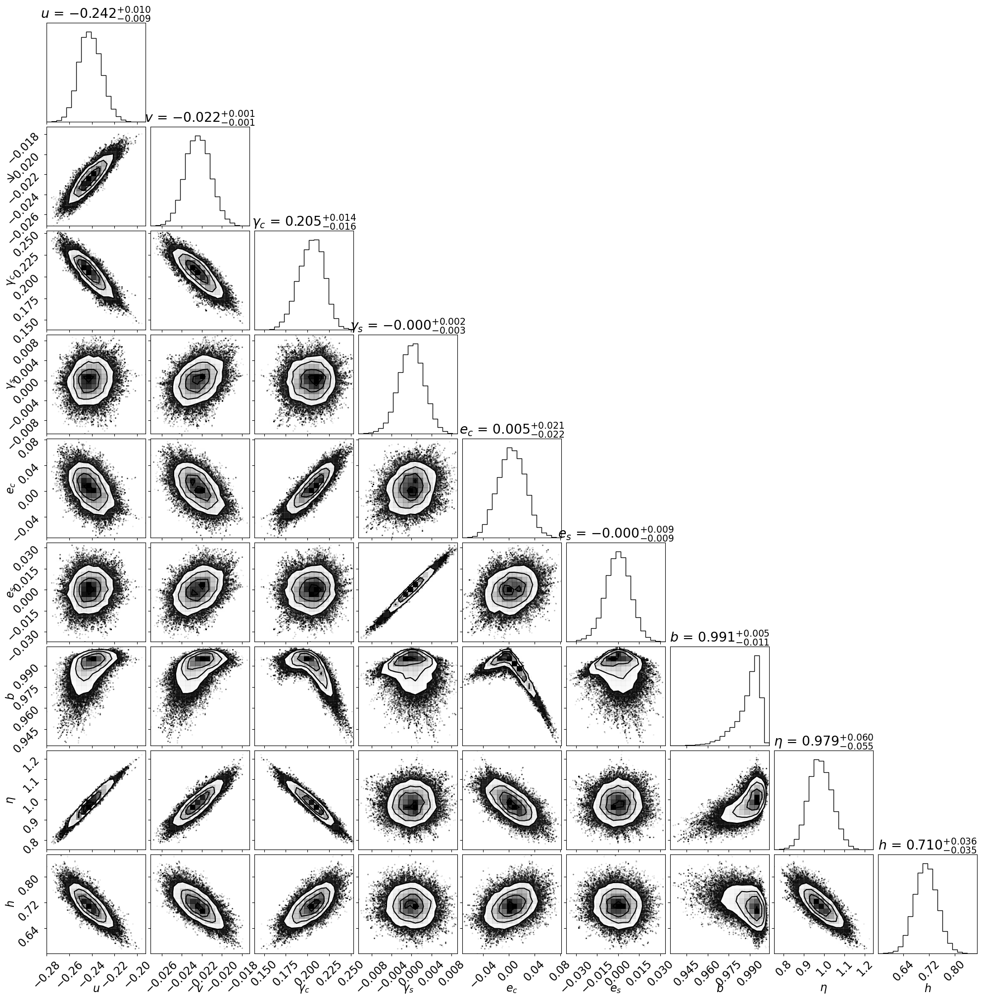

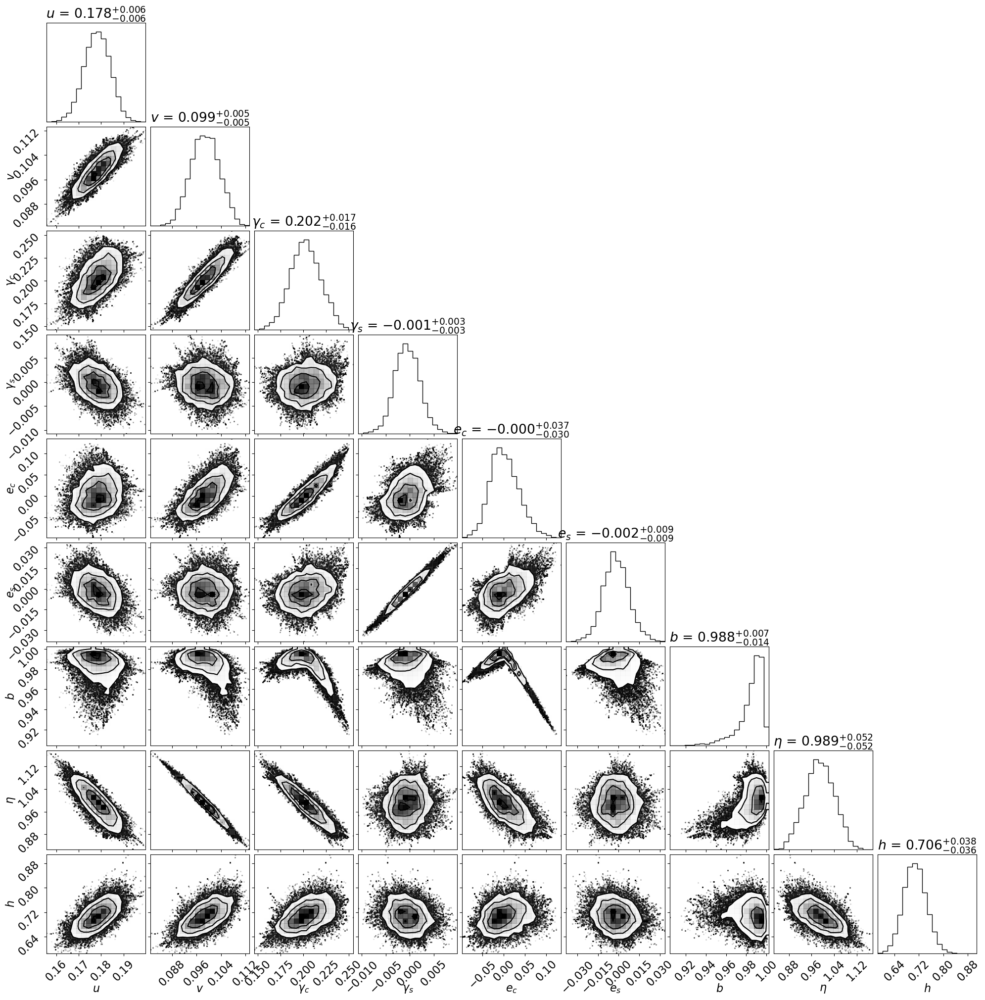

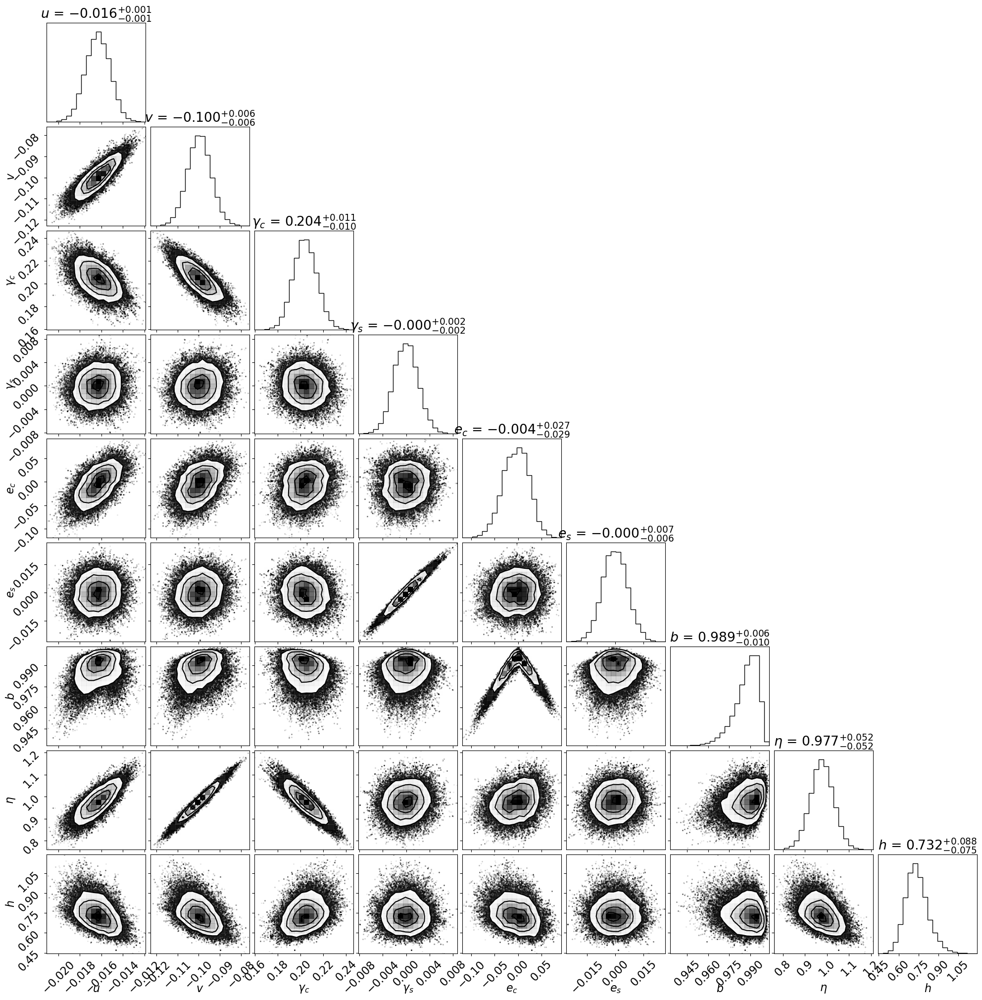

...

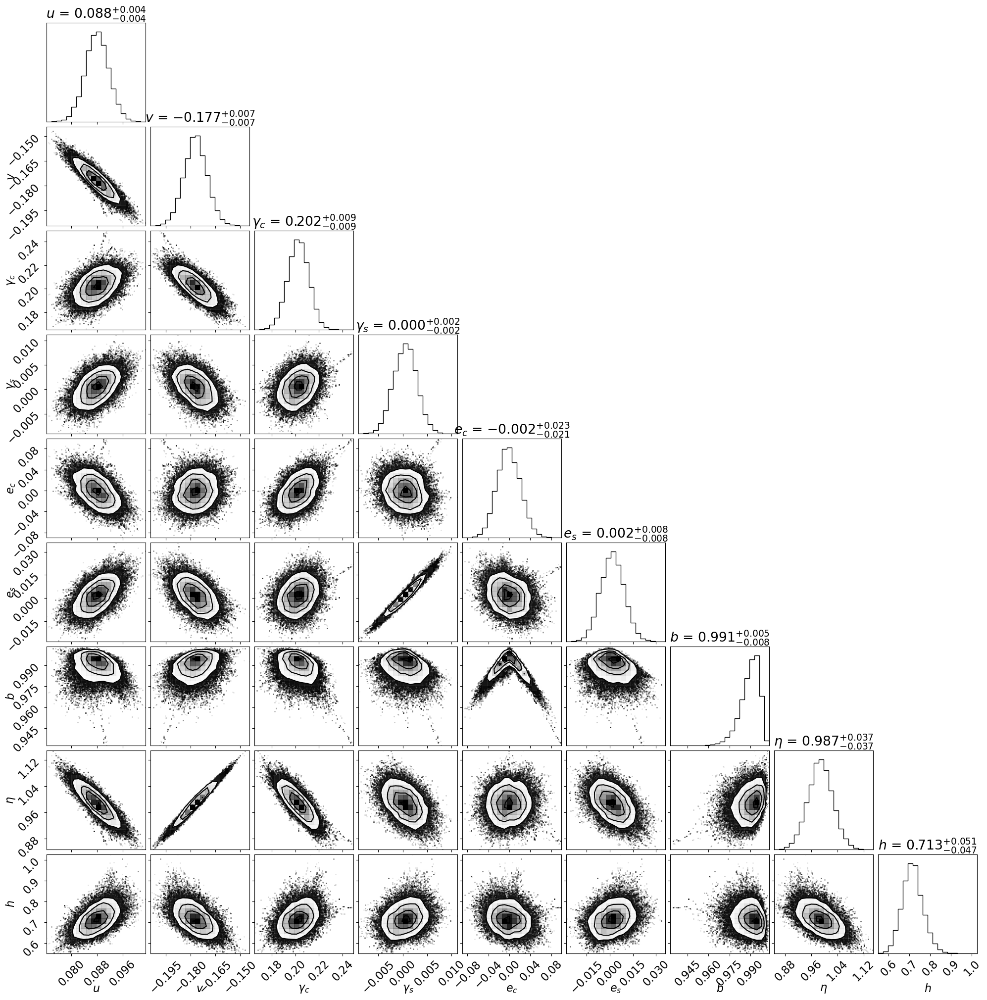

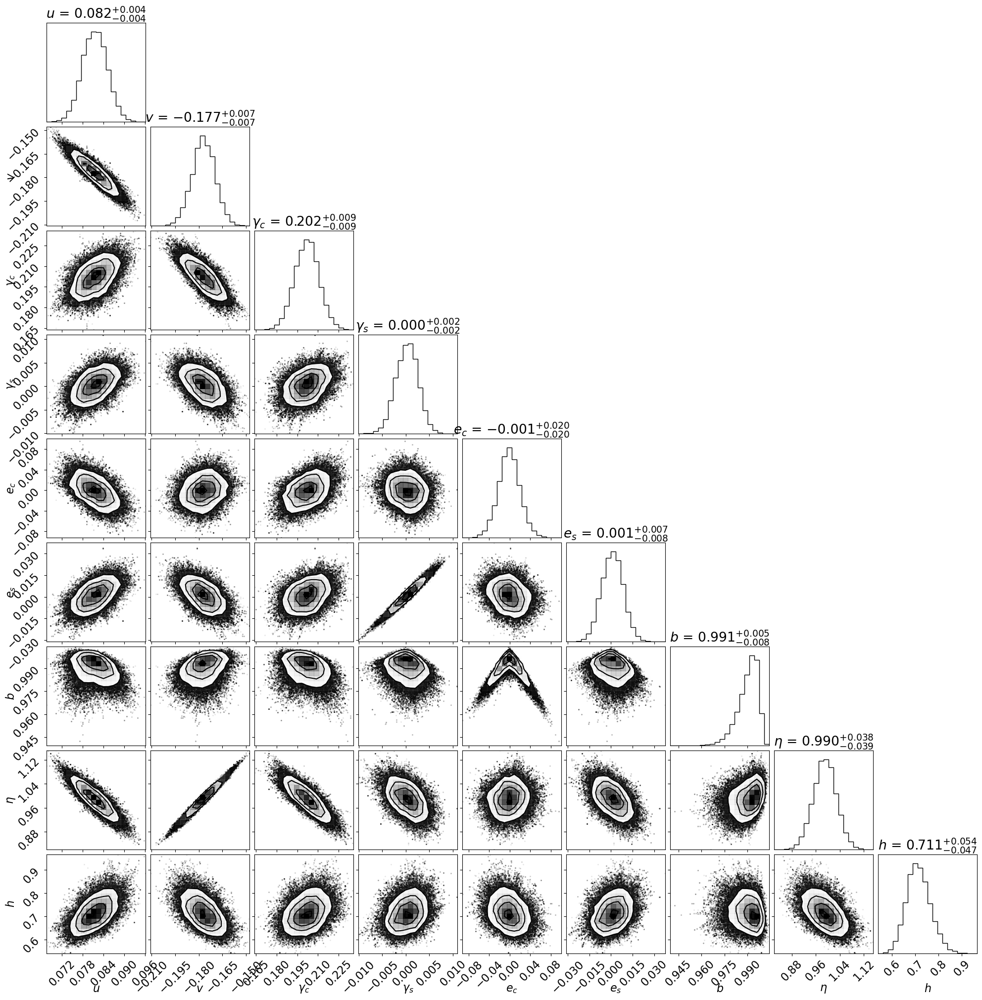

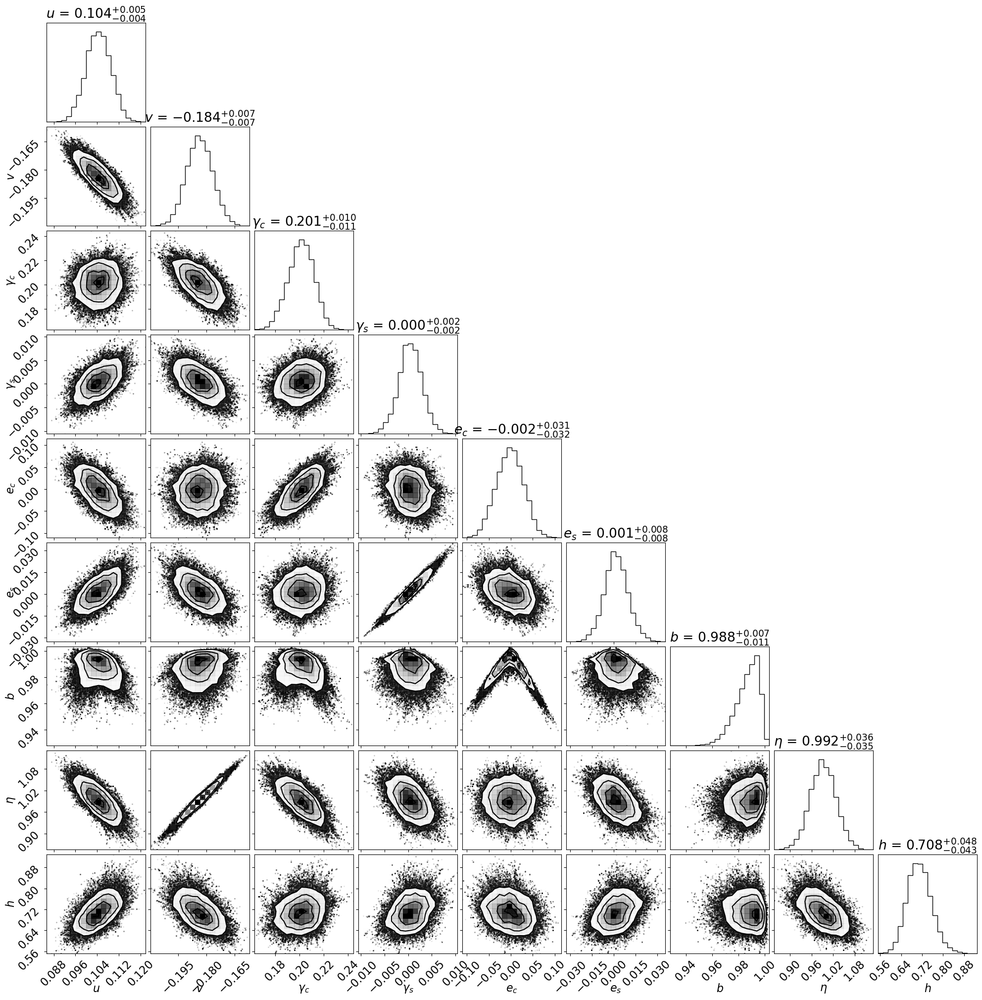

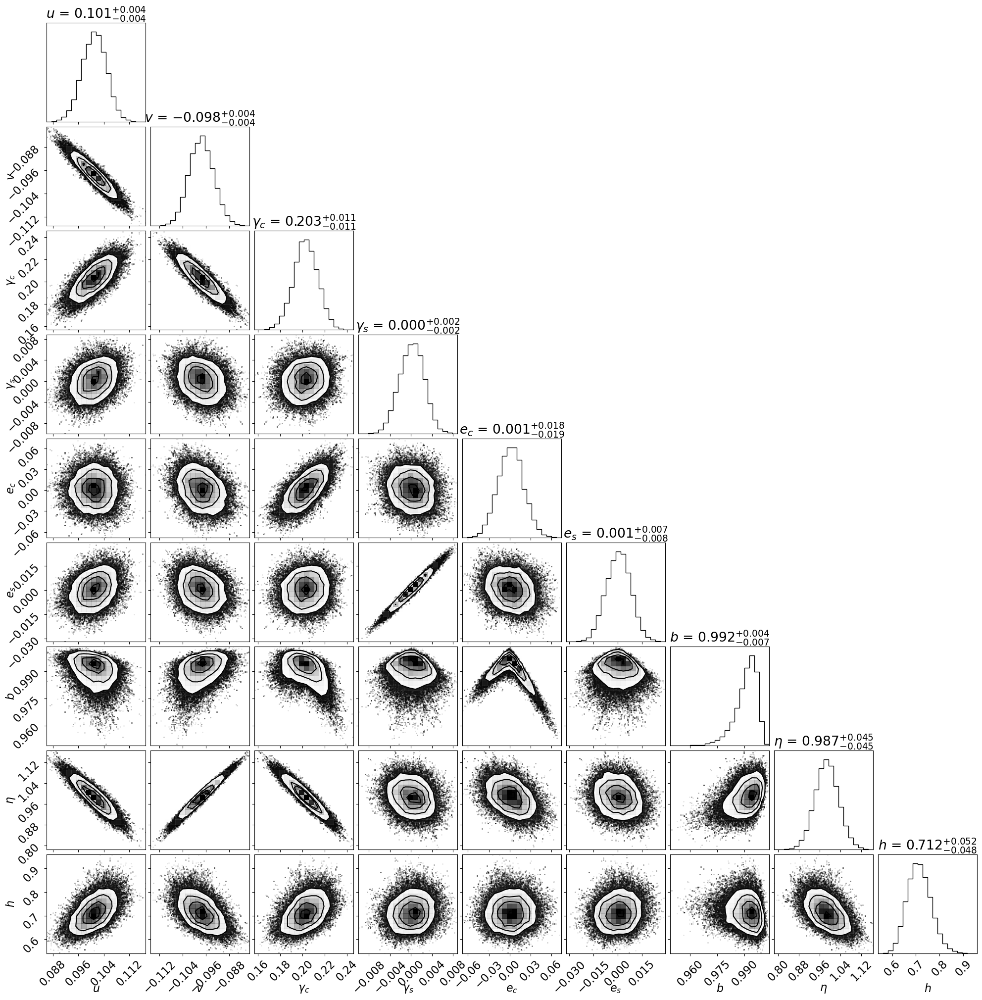

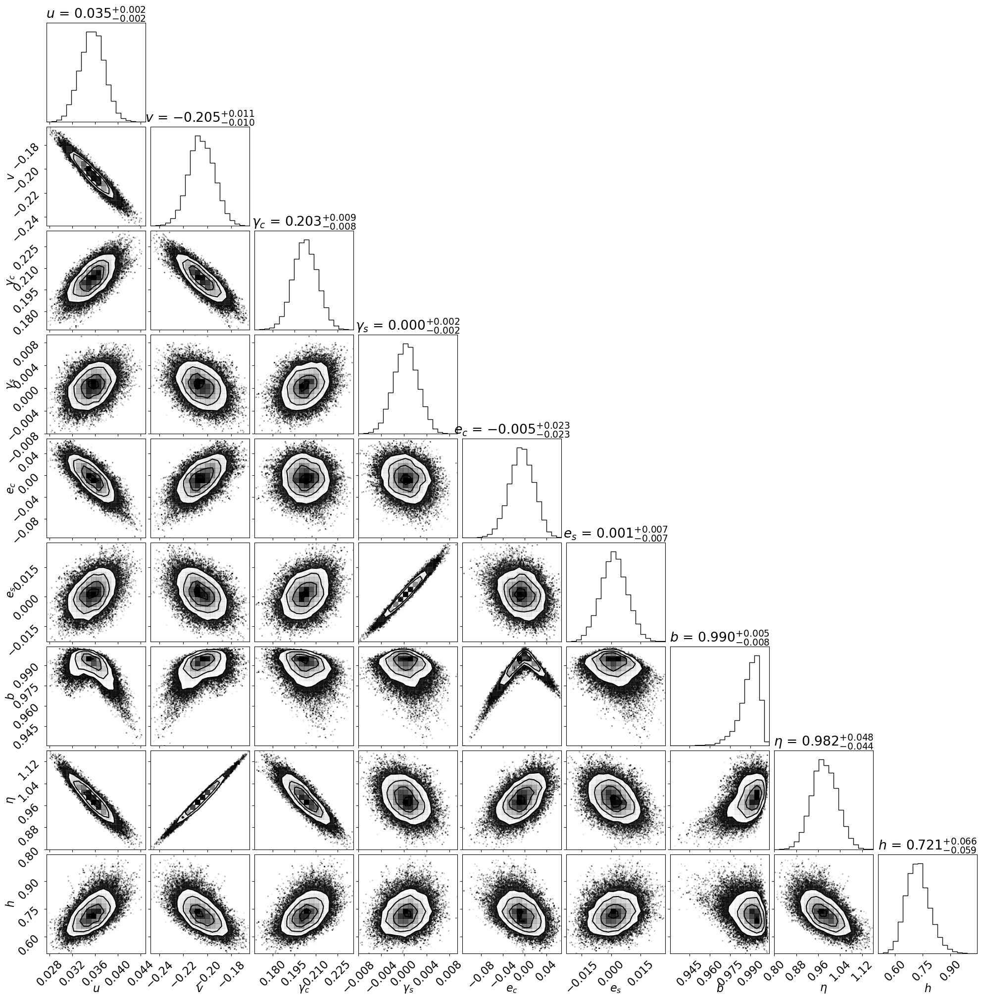

In [17]:
nopt = 200
nwalk = 100
nburn = 2000
nmain = 2000
ellip = True

### MCMC FUNCTION - optimizes for source position before analysis
for n in range(1,n_samples+1):
    basename=folder+root+str(n)
    # load the lens data
    quad = lens.lens(basename+'.dat',zlens,zsrc,cosmo100, Amode='b', fluxmode='optimize')
    
    pbest = quad.opt_MCin(nopt, basename,basename,zlens, zsrc, ellip=True,eta_range=[0.5,1.5], 
              mode='fullsum1', fluxmode='optimize')
    
    #chibest, pbest = optiminitial(basename, quad, ellip, nopt=nopt)
    
    samples = quad.runMC(pstart=pbest,mode='fullsum1',ellip=ellip,nwalk=nwalk,nburn=nburn,nmain=nmain,outname=basename)
    
    # check optimizing from one of the samples
    print('final optimization:')
    opt = quad.optimize(samples[0],mode='fullsum1',ellip=ellip)
    print(opt[1],opt[0])

In [21]:
### READ INFO FROM MCMC FITS:
info = relCK.get_info(datfiles)
heta = h_eta.get_info(files, bests, eta_tracker=1.0, increment=0.)
eta_bias = np.abs(1-np.array(heta[3]))
h_bias = np.abs(0.7-np.array(heta[0]))

imgpos, drarr, taumat
h_med, h_err, eta_true, eta_med, eta_err, h_best, eta_best


In [37]:
drarr = info[1]
taumat = info[2]
ann14 = drarr[:,3]
ann13 = drarr[:,2]
ann12 = drarr[:,1]
tau14 = taumat[:,0,3]
tau13 = taumat[:,0,2]
tau12 = taumat[:,0,1]

eta_med = heta[3]
h_med = heta[0]
eta_err = heta[4]
h_err = heta[1]

Text(0.5, 0, '$\\Delta r_{1,2}$ [arcsec]')

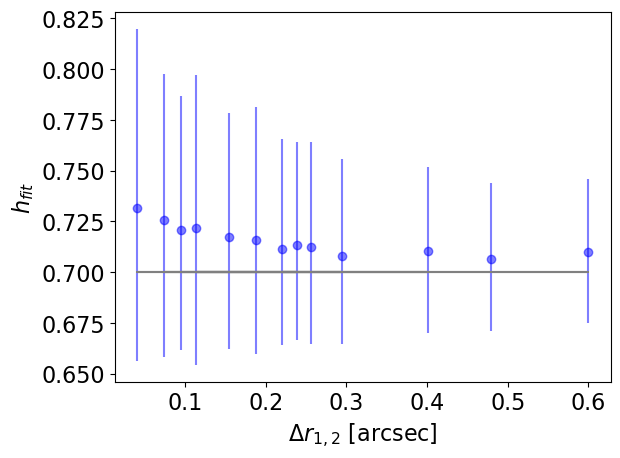

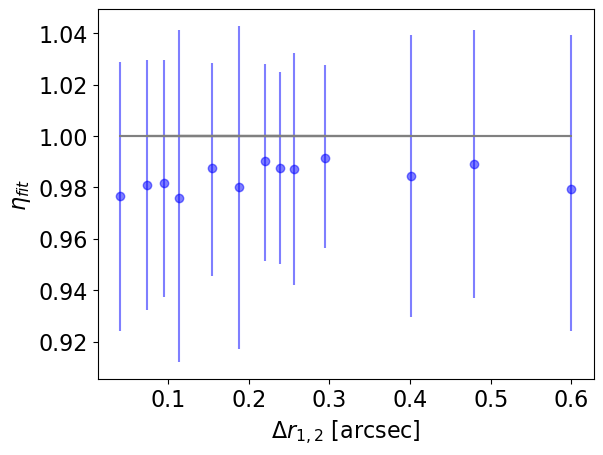

In [38]:
### PLOT MCMC BEST-FIT VALUES FOR H AND ETA AS A FUNCTION OF ANNULUS LENGTH
#############################################################
X = ann12
xlabel = '$\Delta r_{1,2}$ [arcsec]'
xfile = 'annulus-length'
c='blue'
#############################################################

bias = h_bias
plt.figure()
plt.errorbar(X, h_med, yerr=[ h_err[0], h_err[1] ], marker='o', linestyle='', color=c, alpha=0.5)
plt.plot(X, [h_true]*len(X), linestyle='-', color='grey')
plt.ylabel('$h_{fit}$')
plt.xlabel(xlabel)

bias = eta_bias
plt.figure()
plt.errorbar(X, eta_med, yerr=[ eta_err[0], eta_err[1] ], marker='o', color=c, linestyle='', alpha=0.5)
plt.plot(X, [eta_true]*len(X), linestyle='-', color='grey')
plt.ylabel('$\\eta_{fit}$')
plt.xlabel(xlabel)